In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.datasets import fetch_openml

from sklearn.decomposition import PCA, KernelPCA
from sklearn.preprocessing import StandardScaler

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
#mycmap = ListedColormap(["blue","red","gold","green","purple","orange","pink","brown","gray"])
mycmap = ListedColormap(["blue","red", "gold"])
import plotly.graph_objects as go


### Data preparation

In [5]:
#select a specific seed
np.random.seed(8)


In [6]:
pixels, label = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)
label = label.astype(int)
pixels = np.where(pixels / np.max(pixels) > 0.5, 1, 0).astype(int)

dataframe = { "label": label, "pixels": [px for px in pixels] }
df = pd.DataFrame(dataframe)

N = 1000
dataset = df[df["label"] <= 2] # select only 0, 1, 2 values
valSet = dataset[N:N+400]
dataset = dataset[0:N]
data = dataset["pixels"].to_list()
label = dataset["label"].to_list()


In [7]:
def sigmoid(x):
    """Compute the sigmoid activation function."""
    x = np.clip(x, -500, 500)  # Avoid overflow
    return 1 / (1 + np.exp(-x))

def hidden_to_visible(hidden, model):
    w = model.components_
    a = model.intercept_visible_
    prob_visible = sigmoid(np.dot(hidden, w) + a)
    v = (prob_visible > np.random.rand(*prob_visible.shape)).astype(int)
    return v

def visible_to_hidden(visible, model):
    w = model.components_
    b = model.intercept_hidden_
    prob_hidden = sigmoid(np.dot(w, visible) + b)
    h = (prob_hidden > np.random.rand(*prob_hidden.shape)).astype(int)
    return h


### Train RBM using sklearn

In [8]:
# Train RBM
from sklearn import linear_model
from sklearn.neural_network import BernoulliRBM
from sklearn.pipeline import Pipeline

"https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.BernoulliRBM.html"
model = BernoulliRBM(n_components=24, learning_rate=0.1, n_iter=200, verbose=0, random_state=0)
RBM_fit = model.fit(data, label)

# Extract the weights and biases
w = model.components_
a = model.intercept_visible_
b = model.intercept_hidden_

# Extract the hidden layer
h = model.transform(data)

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(h)


### Standardize data and compute the PCA of the hidden

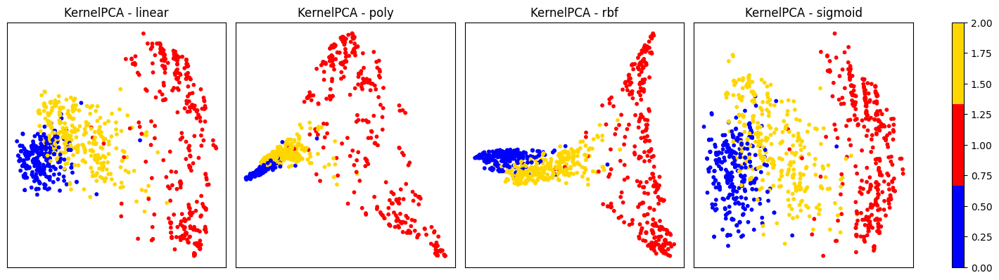

In [9]:
# Perform PCA (kernel='linear' for the usual PCA)

KERNEL = ['linear', 'poly', 'rbf', 'sigmoid']
fig, axs = plt.subplots(1, 4, figsize=(14, 4))

for i in range(len(KERNEL)):
    pca = KernelPCA(n_components=2, kernel=KERNEL[i], fit_inverse_transform=True, gamma=0.05)
    X_pca = pca.fit_transform(scaled_data)

    axs[i].scatter(X_pca[:, 0], X_pca[:, 1], c=label, cmap=mycmap, s=10)
    axs[i].set_title(f"KernelPCA - {KERNEL[i]}")
    axs[i].set_xticks([])
    axs[i].set_yticks([])
plt.tight_layout()
plt.colorbar(axs[0].collections[0], ax=axs, orientation='vertical', fraction=0.02, pad=0.04)
plt.show()


In [10]:
# Perform PCA (kernel='linear' for the usual PCA)
pca = KernelPCA(n_components=3, kernel='linear', fit_inverse_transform=True)
X_pca = pca.fit_transform(scaled_data)

#print("Explained variance from the first 3 components:", np.sum(pca.explained_variance_ratio_))

fig = go.Figure(data=[go.Scatter3d(x=X_pca[:,0], y=X_pca[:,1], z=X_pca[:,2], mode='markers',
				marker=dict(size=5, color=label, colorscale=mycmap.colors, opacity=0.8))])
fig.update_layout(width=800, height=800, margin=dict(l=0,r=0,b=0,t=0,pad=0))
fig.show()


---

### Energy calculation for each 3D-PCA space point
Projection from 3D (PCA space) to 24D (hidden space) and from 24D to 784D (visible space)

In [11]:
grid = np.linspace(-5, 5, 30)
xx, yy, zz = np.meshgrid(grid, grid, grid)

# generate h and v for each point in the grid
# apply inverse PCA and inverse scaler to find h
h_generated = scaler.inverse_transform(pca.inverse_transform(np.c_[xx.ravel(), yy.ravel(), zz.ravel()]))
v_generated = hidden_to_visible(h_generated, model)

# Contrasting divergence using gibbs sampling
for _ in range(3):
    v_generated = model.gibbs(v_generated)


In [12]:
E = np.zeros(h_generated.shape[0])
for i in range(len(E)):
    v = v_generated[i,:]
    h = h_generated[i,:]
    E[i] = -np.dot(v, a) -np.dot(h, b) - np.dot(v, np.dot(h, w))


In [13]:
fig = go.Figure(data=go.Volume(
    x=xx.flatten(), y=yy.flatten(), z=zz.flatten(),
    value=E,
    #isomin=0.2,
    #isomax=0.7,
    opacity=0.05,
    surface_count=30,
    colorscale="Magma",
    reversescale=True,
    colorbar={"title": "Energy"}
    ))

fig.add_trace(go.Scatter3d(
    x=X_pca[:,0],
    y=X_pca[:,1],
    z=X_pca[:,2],
    mode="markers",
    marker=dict(
        size=3,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    name="Hidden Points"
))

fig.update_layout(width=800, height=800, title="Energy Landscape of RBM",
                  scene=dict(
                      xaxis_title="PCA0",
                      yaxis_title="PCA1",
                      zaxis_title="PCA2"
                  ))
fig.show()


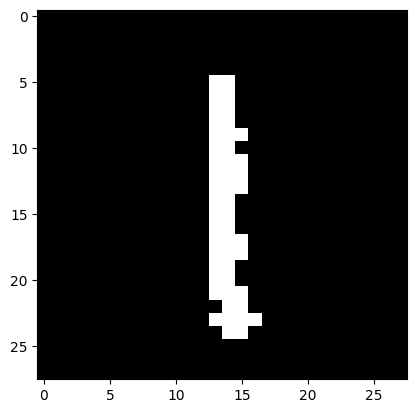

In [14]:
# Generation test
coordinates = np.array([[3, -1, -1]])
h_pick = pca.inverse_transform(coordinates)
v_pick = (scaler.fit_transform(hidden_to_visible(h_pick, model).reshape(-1, 1))).reshape(-1)
for _ in range(10):
    v_pick = model.gibbs(v_pick)

plt.imshow(np.reshape(v_pick, (28, 28)), cmap="gray")
plt.show()


----

## Classification test

In [15]:
def project(visible, model, pca):
    """
    This will return the 3D PCA representation of the hidden units in the input dataframe
    """
    hidden = visible_to_hidden(visible, model)  # get the hidden representation
    pca_proj = pca.transform(hidden.reshape(1, -1))[0]  # project the hidden into PCA space
    return pca_proj

def findClosestCluster(point, k):
    """
    This function will return the k-closest cluster for each point
    """
    minDist = [float("inf")]*k
    closestCluster = [-1]*k
    for i,sample in enumerate(X_pca):
        dist = np.linalg.norm(point - sample)             ## !!!! The metric in the space is not euclidean, so this is just an approx
        if dist < max(minDist):
            idx = minDist.index(max(minDist))
            minDist[idx] = dist
            closestCluster[idx] = label[i]
    return max(set(closestCluster), key = lambda x: (closestCluster.count(x),-closestCluster.index(x)))

def classify(point, model, pca, rep=1, kneigh=5):
    """
    This function will classify a given point based on its euclidean distance to the k-closest samples
    Since this approach is stochastic (the hidden representation of the visible points is different at every run due to the CD algorithm)
    We repeat the process _rep_ times and take the clusters that appears the most in those repetitions (majority voting)
    """
    res = []
    for j in range(rep):
        projected = project(point, model, pca)
        c = findClosestCluster(projected,kneigh)
        res.append(c)
    return max(set(res), key = lambda x: (res.count(x),-res.index(x)))

def computeAccuracy(valSet):
    """
    This function will compute the accuracy of the model on the validation set
    """
    clusters = [classify(point, rep = 5, kneigh = 15) for point in valSet["pixels"].values]
    acc = np.sum(clusters == valSet["label"].values)/len(clusters)
    return acc


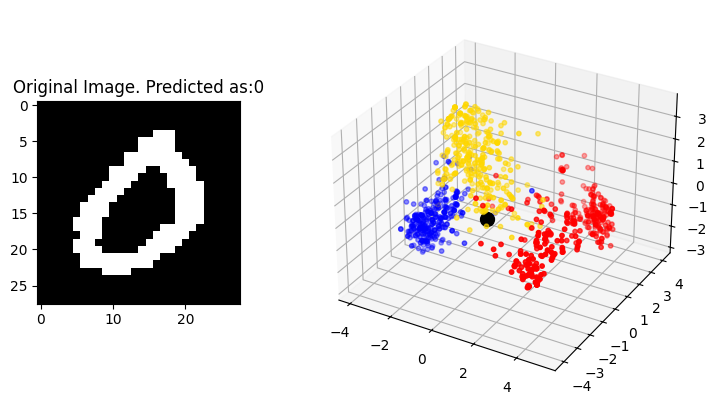

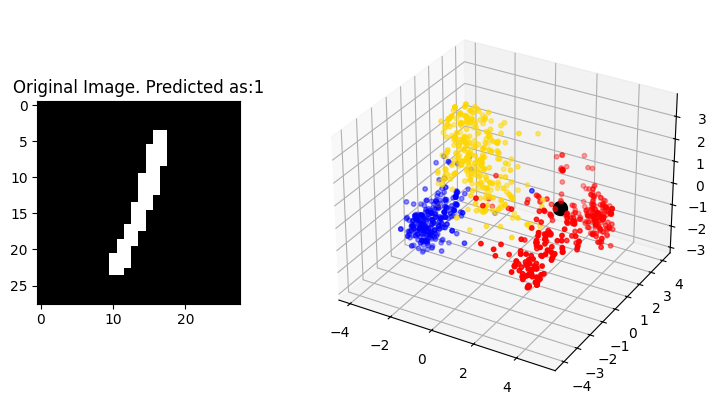

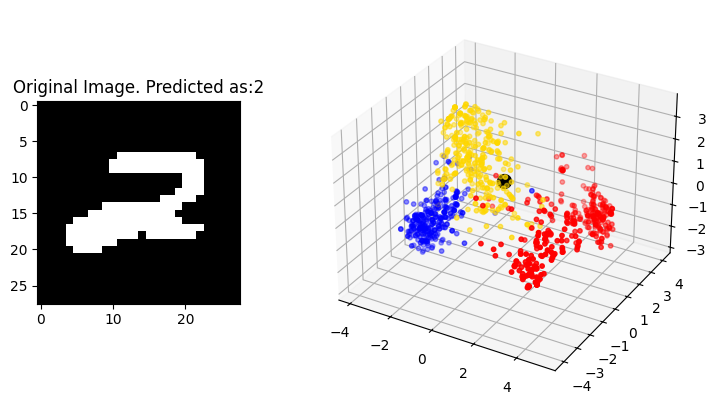

In [16]:
# let us apply this algorithm to a bunch of points in the validation set
for j in [3,4,5]:
    newSample = valSet.iloc[j,1]
    projected = project(newSample, model, pca)
    cluster = findClosestCluster(projected, 10)

    fig = plt.figure(figsize=(12, 5))
    ax1 = fig.add_subplot(141) 
    ax1.imshow(newSample.reshape(28,28), cmap="gray")
    ax1.set_title("Original Image. Predicted as:"+str(cluster))
    ax2 = fig.add_subplot(projection='3d')
    ax2.scatter(projected[0], projected[1], projected[2], s = 100, c="black")
    ax2.scatter(X_pca[:,0], X_pca[:,1], X_pca[:,2], c=label,s = 10, cmap=mycmap)
    plt.show()


In [17]:
#for j in range(5):
    #print(f"Accuracy of the RBM classifier: ", computeAccuracy(valSet))


----

## Analysis of the energetic landscape

In [18]:
model = BernoulliRBM(n_components=24, learning_rate=0.1, n_iter=200, verbose=0, random_state=0)
RBM_fit = model.fit(data, label)

# Extract the weights and biases
w = model.components_
a = model.intercept_visible_
b = model.intercept_hidden_

h = model.transform(data)

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(h)

data0 = scaled_data[np.where(np.array(label) == 0)]
data1 = scaled_data[np.where(np.array(label) == 1)]
data2 = scaled_data[np.where(np.array(label) == 2)]


### - Discrete case (Hamming path)

In [19]:
def hamming_path(init, fin):
    """ 
    This function takes in two points in a D-dimensional Manhattan space and return a Hamming path connecting those two points
    """
    init = np.array(init, dtype=int) 
    fin = np.array(fin, dtype =int)
    path = [init.copy()] 
    for i in range(len(init)):
        if init[i] != fin[i]:  
            init[i] = fin[i] 
            path.append(init.copy())  
    
    return path

data0 = h[np.where(np.array(label) == 0)]
data1 = h[np.where(np.array(label) == 1)]
data2 = h[np.where(np.array(label) == 2)]


Energetic gap:  115.0008524921496


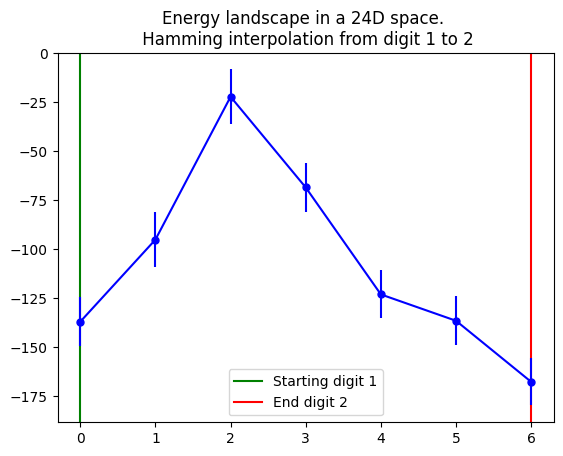

In [20]:
# choose a digit randomly
chosenDigit = (data0[np.random.randint(0, len(data0))],  data1[np.random.randint(0, len(data1))], data2[np.random.randint(0, len(data2))])

#choose the starting digit and the final digit
digitfrom = 1
digitto = 2

# build the "path" in the Hamming sense (from start to end modifying just a bit at each step)
line = hamming_path(chosenDigit[digitfrom], chosenDigit[digitto])
assert (np.all(line[0] == chosenDigit[digitfrom].astype(int)))
assert (np.all(line[-1] == chosenDigit[digitto].astype(int)))

# We will "extend" the path over the last point by adding a few points (again, a bit by step)
# If not interested, just let added=0
added = 0
idx = np.random.choice(list(range(24)), added, replace=False)
for k in range(added):
    new = line[-1].copy()
    if new[idx[k]] == 0:
        new[idx[k]] = 1
    elif new[idx[k]] == 1:
        new[idx[k]] = 0
    line.append(new)
assert(np.sum(line[-added-1]!=line[-1]) == added)

# start performing the hamming morphing
energiess = []
stds = []
for i in line:
    currentHidden = i
    en_tmp = np.zeros(500)       # for every point, average the energy over 500 points (?)
    for j in range(500):
        vis = hidden_to_visible(currentHidden, model)        # we are basically averaging over the visible produced by a fixed hidden
        en = -np.dot(vis, a) - np.dot(currentHidden, b) - np.dot(vis, np.dot(currentHidden, w))
        en_tmp[j] = en
    energiess.append(np.mean(en_tmp))
    stds.append(np.std(en_tmp))

highestEnergy = max(energiess)
minGap = highestEnergy-energiess[0]
print("Energetic gap: ", minGap)

plt.axvline(x = 0, c="green", label = f"Starting digit {digitfrom}")
plt.axvline(x = len(line)-1-added, c="red", label=f"End digit {digitto}")
plt.legend(loc="best")
plt.title(f"Energy landscape in a 24D space. \n Hamming interpolation from digit {digitfrom} to {digitto}")
plt.errorbar(list(range(len(line))), energiess, stds, markersize=5, marker="o", color="blue")
plt.show()


Now let's try to compute the average energetic gap for a given pair of digit:

In [20]:
# We'll start with 0 -> 1
minGap01 = []
rep = 5000

size0 = len(data0)
size1 = len(data1)
cartesianProduct = [(d0, d1) for d0 in data0 for d1 in data1]
indices = np.random.choice(range(size0*size1), rep, replace=False)
print(size0*size1)
for l in range(rep):
        chosenDigit = cartesianProduct[l]
      
        # build the "path" in the Hamming sense (from start to end modifying just a bit at each step)
        hidden0 = chosenDigit[0]
        hidden1 = chosenDigit[1]
        line = hamming_path(hidden0, hidden1)
        if(len(line) > 4):   
            assert (np.all(line[0] == hidden0.astype(int)))
            assert (np.all(line[-1] == hidden1.astype(int)))

            energiess = []
            stds = []
            for i in line:
                currentHidden = i
                en_tmp = np.zeros(200)
                for j in range(200):
                    vis = hidden_to_visible(currentHidden, model)
                    en = -np.dot(vis, a) - np.dot(currentHidden, b) - np.dot(vis, np.dot(currentHidden, w))
                    en_tmp[j] = en
                energiess.append(np.mean(en_tmp))
                stds.append(np.std(en_tmp))

            highestEnergy = max(energiess)
            minGap = highestEnergy-energiess[0]
            minGap01.append(minGap)
#minGap01 = np.array(minGap01)[np.where(np.array(minGap01) > 0.01)]


112893


KeyboardInterrupt: 

Avg energy gap 0-1:  111.21410623750488


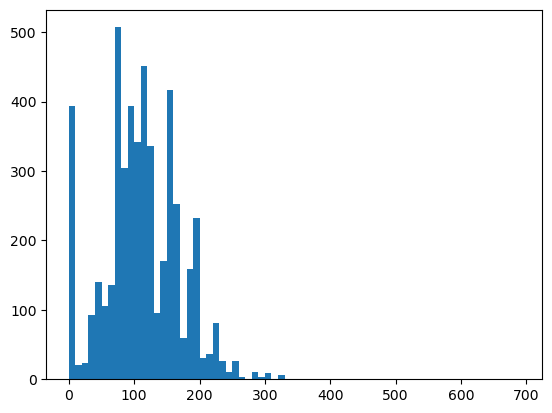

In [ ]:
print("Avg energy gap 0-1: ", np.mean(minGap01))
plt.hist(minGap01, bins = np.arange(0,700,10), alpha = 1, label = "0-1")
plt.show()


In [ ]:
minGap02 = []
size0 = len(data0)
size2 = len(data2)
cartesianProduct = [(d0, d2) for d0 in data0 for d2 in data2]
indices = np.random.choice(range(size0*size2), rep, replace=False)
print(size0*size2)
for l in range(rep):
        chosenDigit = cartesianProduct[l]
      
        # build the "path" in the Hamming sense (from start to end modifying just a bit at each step)
        hidden0 = chosenDigit[0]
        hidden1 = chosenDigit[1]
        line = hamming_path(hidden0, hidden1)
        if(len(line) > 4):   
            assert (np.all(line[0] == hidden0.astype(int)))
            assert (np.all(line[-1] == hidden1.astype(int)))

            energiess = []
            stds = []
            for i in line:
                currentHidden = i
                en_tmp = np.zeros(200)
                for j in range(200):
                    vis = hidden_to_visible(currentHidden, model)
                    en = -np.dot(vis, a) - np.dot(currentHidden, b) - np.dot(vis, np.dot(currentHidden, w))
                    en_tmp[j] = en
                energiess.append(np.mean(en_tmp))
                stds.append(np.std(en_tmp))

            highestEnergy = max(energiess)
            minGap = highestEnergy-energiess[0]
            minGap02.append(minGap)
#minGap02 = np.array(minGap02)[np.where(np.array(minGap02) > 0.01)]


101386


Avg energy gap 0-2:  97.5901951897281


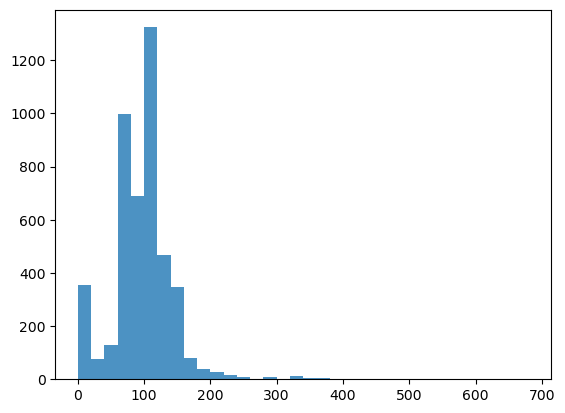

In [ ]:
print("Avg energy gap 0-2: ", np.mean(minGap02))
plt.hist(minGap02, bins = np.arange(0,700,20), alpha = 0.8, label = "0-1")
plt.show()


In [ ]:
minGap12 = []
size0 = len(data0)
size2 = len(data1)
cartesianProduct = [(d1, d2) for d1 in data1 for d2 in data2]
indices = np.random.choice(range(size1*size2), rep, replace=False)
print(size1*size2)
for l in range(rep):
        chosenDigit = cartesianProduct[l]
      
        # build the "path" in the Hamming sense (from start to end modifying just a bit at each step)
        hidden0 = chosenDigit[0]
        hidden1 = chosenDigit[1]
        line = hamming_path(hidden0, hidden1)
        if(len(line) > 4):   
            assert (np.all(line[0] == hidden0.astype(int)))
            assert (np.all(line[-1] == hidden1.astype(int)))

            energiess = []
            stds = []
            for i in line:
                currentHidden = i
                en_tmp = np.zeros(200)
                for j in range(200):
                    vis = hidden_to_visible(currentHidden, model)
                    en = -np.dot(vis, a) - np.dot(currentHidden, b) - np.dot(vis, np.dot(currentHidden, w))
                    en_tmp[j] = en
                energiess.append(np.mean(en_tmp))
                stds.append(np.std(en_tmp))

            highestEnergy = max(energiess)
            minGap = highestEnergy-energiess[0]
            minGap12.append(minGap)


131769


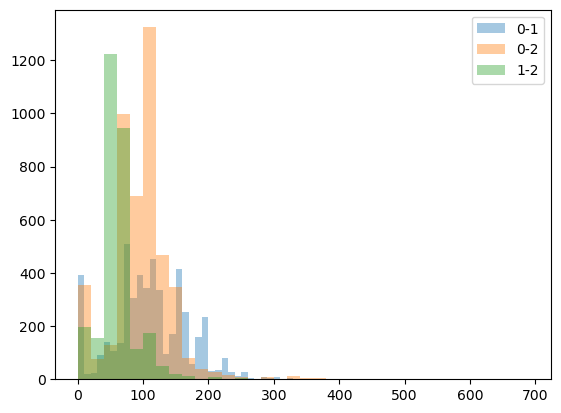

Avg energy gap 0-1:  111.21410623750488
Avg energy gap 0-2:  97.5901951897281
Avg energy gap 1-2:  61.54580041168858


In [ ]:
minGap12 = np.array(minGap12)[np.where(np.array(minGap12) > 0.01)]
plt.hist(minGap01, bins = np.arange(0,700,10), alpha = 0.4, label = "0-1")
plt.hist(minGap02, bins = np.arange(0,700,20), alpha = 0.4, label = "0-2")
plt.hist(minGap12, bins = np.arange(0,700,20),  alpha = 0.4, label = "1-2")
plt.legend(loc="best")
plt.show()

print("Avg energy gap 0-1: ", np.mean(minGap01))
print("Avg energy gap 0-2: ", np.mean(minGap02))
print("Avg energy gap 1-2: ", np.mean(minGap12))


### Continuous case

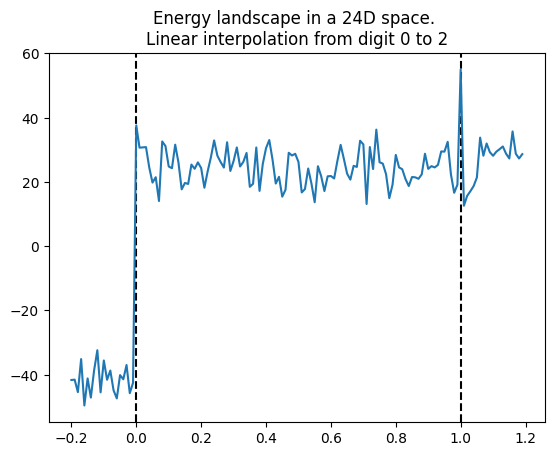

In [21]:
# In this specific case, we'll use the scaled data
data0 = scaled_data[np.where(np.array(label) == 0)]
data1 = scaled_data[np.where(np.array(label) == 1)]
data2 = scaled_data[np.where(np.array(label) == 2)]

h0 = data0[np.random.randint(0, len(data0))]
h1 = data1[np.random.randint(0, len(data1))]
h2 = data2[np.random.randint(0, len(data2))]

energiess = []
steps = 0.01
ranget = np.arange(-0.2,1.2,0.01)

diff = h1 - h2
line = [h2 + diff*t for t in ranget]

for i in range(len(line)):
    hid = scaler.inverse_transform(line[i].reshape(1,-1)).astype(int)[0]
    
    en_tmp = np.zeros(20)
    for j in range(20):
        vis = hidden_to_visible(hid, model)
        en = -np.dot(vis, a) - np.dot(currentHidden, b) - np.dot(vis, np.dot(currentHidden, w))
        en_tmp[j] = en
    energiess.append(np.mean(en_tmp))

plt.axvline(x=0, color='black', linestyle='--')
plt.axvline(x=1, color='black', linestyle='--')
plt.title("Energy landscape in a 24D space. \nLinear interpolation from digit 0 to 2")
plt.plot(ranget, energiess)
plt.show()


-11067.660266086436


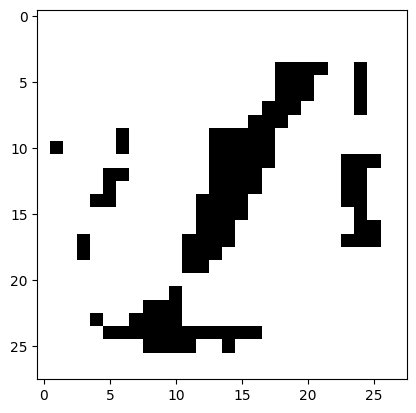

In [22]:
extreme = h0 - diff*1.5
prob_visible = sigmoid(np.dot(extreme, w) + a)
v = (prob_visible > np.random.rand(*prob_visible.shape)).astype(int)
en = -np.dot(v, a) - np.dot(extreme, b) - np.dot(v, np.dot(extreme, w))
print(en)

plt.imshow(v.reshape((28,28)), cmap = "gray")


In [23]:
#Energy on a 3D straight line analysis
h = model.transform(data)

#find the coordinates of two points belonging to two different clusters
data0 = h[np.where(np.array(label) == 0)]
data1 = h[np.where(np.array(label) == 1)]
data2 = h[np.where(np.array(label) == 2)]

# choose a digit randomly
chosenDigit = (data0[np.random.randint(0, len(data0))],  data1[np.random.randint(0, len(data1))], data2[np.random.randint(0, len(data2))])
print(chosenDigit[0])
v0_generated = hidden_to_visible(chosenDigit[0], model)
v1_generated = hidden_to_visible(chosenDigit[1], model)
v2_generated = hidden_to_visible(chosenDigit[2], model)


[9.34464278e-022 5.25520673e-004 1.00000000e+000 1.24856136e-026
 4.62932713e-058 2.83716794e-070 2.78038363e-110 1.00000000e+000
 9.99723116e-001 4.86298822e-030 1.00000000e+000 1.00000000e+000
 2.79197785e-051 4.49270705e-013 1.55669333e-007 9.51663169e-001
 1.00000000e+000 5.27230511e-063 8.74754214e-039 9.99999721e-001
 1.30540329e-092 5.57881145e-080 9.78243712e-044 1.00000000e+000]


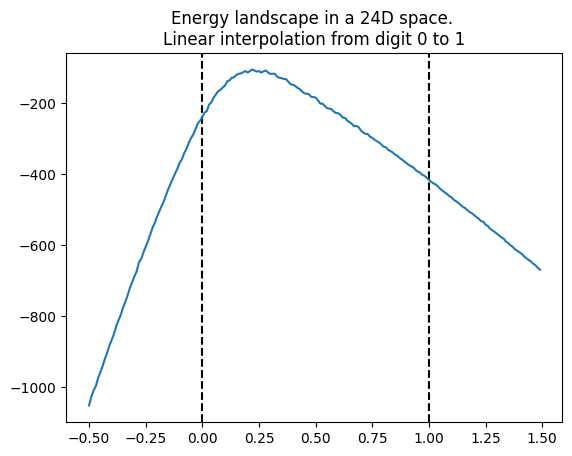

<Figure size 1200x500 with 0 Axes>

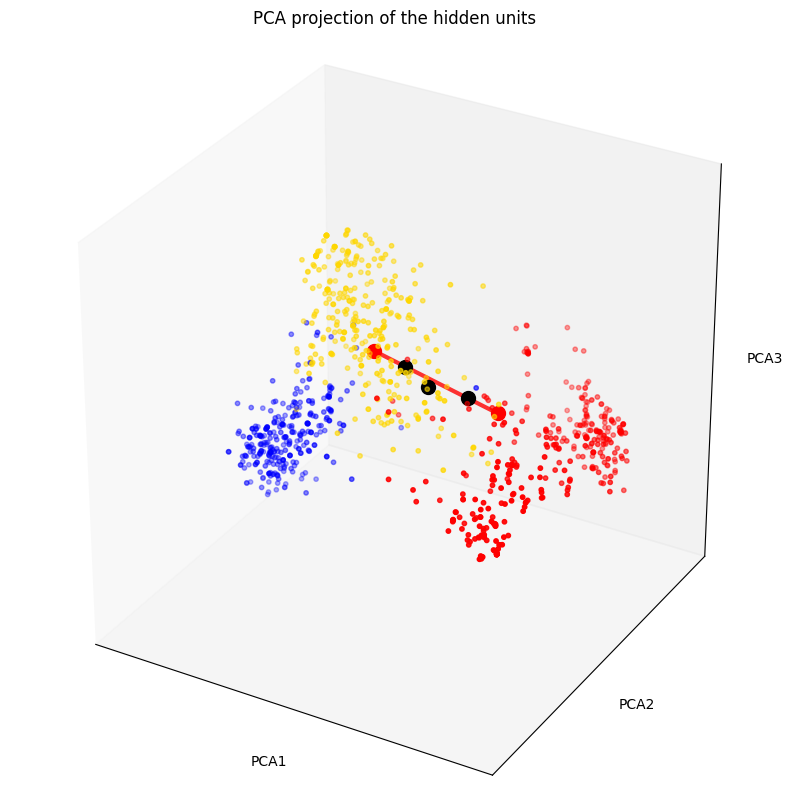

In [24]:
#calculate the point of the lines and the energy
ranget = np.arange(-0.5,1.5,0.01)
energiess = []
line = []

k=-1
for i in ranget:
    k += 1
    line.append(chosenDigit[0] + (chosenDigit[1]-chosenDigit[0])*i)
    #this is a 24D line choosen point by point
    currentHidden = line[k]
    en_tmp = np.zeros(20)
    for j in range(20):
        vis = hidden_to_visible(currentHidden, model)
        en = -np.dot(vis, a) - np.dot(currentHidden, b) - np.dot(vis, np.dot(currentHidden, w))
        en_tmp[j] = en
    energiess.append(np.mean(en_tmp))

plt.axvline(x=0, color='black', linestyle='--')
plt.axvline(x=1, color='black', linestyle='--')
plt.title("Energy landscape in a 24D space. \nLinear interpolation from digit 0 to 1")
plt.plot(ranget, energiess)
plt.show()

#Energy on a 3D straight line analysis
h = model.transform(data)

fig = plt.figure(figsize=(12, 5))
#scatter the points in the PCA space in a new figure
fig = plt.figure(figsize=(24, 10))
ax4 = fig.add_subplot(111, projection='3d')
ax4.set_title("PCA projection of the hidden units")
ax4.set_xlabel("PCA1")
ax4.set_ylabel("PCA2")
ax4.set_zlabel("PCA3")
ax4.set_xlim([-5, 5])
ax4.set_ylim([-5, 5])
ax4.set_zlim([-5, 5])
ax4.set_xticks([])
ax4.set_yticks([])
ax4.set_zticks([])
ax4.set_box_aspect([1,1,1])  # aspect ratio is 1:1:1
ax4.set_facecolor("white")
ax4.scatter(X_pca[:,0], X_pca[:,1], X_pca[:,2], c=label,s = 10, cmap=mycmap)
ax4.scatter(chosenDigit[0][0], chosenDigit[0][1], chosenDigit[0][2], c="black", s = 100)
ax4.scatter(chosenDigit[1][0], chosenDigit[1][1], chosenDigit[1][2], c="black", s = 100)
ax4.scatter(chosenDigit[2][0], chosenDigit[2][1], chosenDigit[2][2], c="black", s = 100)
#plot the line using the previous defined "line" variable
ax4.scatter(line[0][0], line[0][1], line[0][2], c="red", s = 100)
ax4.scatter(line[-1][0], line[-1][1], line[-1][2], c="red", s = 100)
ax4.plot(
    [line[0][0], line[-1][0]],
    [line[0][1], line[-1][1]],
    [line[0][2], line[-1][2]],
    color="red",
    alpha=0.8,
    linewidth=3,
)


In [25]:
fig = go.Figure(data=go.Volume(
    x=xx.flatten(), y=yy.flatten(), z=zz.flatten(),
    value=E,
    #isomin=0.2,
    #isomax=0.7,
    opacity=0.05,
    surface_count=30,
    colorscale="Magma",
    reversescale=True,
    colorbar={"title": "Energy"}
    ))

fig.add_trace(go.Scatter3d(
    x=X_pca[:,0],
    y=X_pca[:,1],
    z=X_pca[:,2],
    mode="markers",
    marker=dict(
        size=3,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    name="Hidden Points"
))

# Add the line and its endpoints
fig.add_trace(go.Scatter3d(
    x=[line[0][0], line[-1][0]],  # Line start and end x-coordinates
    y=[line[0][1], line[-1][1]],  # Line start and end y-coordinates
    z=[line[0][2], line[-1][2]],  # Line start and end z-coordinates
    mode="lines+markers",  # Plot both the line and the endpoints
    line=dict(
        color="black",
        width=3,
    ),
    marker=dict(
        size=6,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    name="Line"
))


fig.update_layout(width=800, height=800, title="Energy Landscape of RBM",
                  scene=dict(
                      xaxis_title="PCA0",
                      yaxis_title="PCA1",
                      zaxis_title="PCA2"
                  ))
fig.show()


In [26]:
# Perform PCA (kernel='linear' for the usual PCA)
ch_pca = pca.transform(chosenDigit)

print(ch_pca)


[[-0.32106615  0.37172872 -0.97561775]
 [ 2.74138921 -1.00099685 -0.37997657]
 [ 0.38220423  0.47484951  0.84088124]]


In [27]:
#create the energy calculating function
def energy(vis, hid):
    E = -np.dot(a, vis.T) - np.dot(b, hid.T) - np.dot(hid, np.dot(w, vis.T))  # Somma pesata
    return(E)


In [39]:
#calculate the point of the lines and the energy
ranget = np.arange(0,1,0.005)
energiess = []
line = []
k=-1
for i in ranget:
    k += 1
    line.append(ch_pca[0] + (ch_pca[2]-ch_pca[0])*i)
    #this is a 3d line choosen point by point
    currentHidden = pca.inverse_transform(line[k].reshape(1,-1))
    en_tmp = np.zeros(20)
    #calculate the energies
    for j in range(20):
        vis = hidden_to_visible(currentHidden, model)
        en = energy(vis, currentHidden)
        en_tmp[j] = en
    energiess.append(np.mean(en_tmp))


plt.axvline(x=0, color='black', linestyle='--')
plt.axvline(x=1, color='black', linestyle='--')
plt.title("Energy landscape in a 3D space. \nLinear interpolation from digit 0 to 2")
plt.plot(ranget, energiess)
plt.show()

#Energy on a 3D straight line analysis
h = model.transform(data)

fig = plt.figure(figsize=(12, 5))
#scatter the points in the PCA space in a new figure
fig = plt.figure(figsize=(24, 10))
ax4 = fig.add_subplot(111, projection='3d')
ax4.set_title("PCA projection of the hidden units")
ax4.set_xlabel("PCA1")
ax4.set_ylabel("PCA2")
ax4.set_zlabel("PCA3")
ax4.set_xlim([-5, 5])
ax4.set_ylim([-5, 5])
ax4.set_zlim([-5, 5])
ax4.set_xticks([])
ax4.set_yticks([])
ax4.set_zticks([])
ax4.set_box_aspect([1,1,1])  # aspect ratio is 1:1:1
ax4.set_facecolor("white")
ax4.scatter(X_pca[:,0], X_pca[:,1], X_pca[:,2], c=label,s = 10, cmap=mycmap)
ax4.scatter(ch_pca[0][0], ch_pca[0][1], ch_pca[0][2], c="black", s = 100)
ax4.scatter(ch_pca[1][0], ch_pca[1][1], ch_pca[1][2], c="black", s = 100)
ax4.scatter(ch_pca[2][0], ch_pca[2][1], ch_pca[2][2], c="black", s = 100)
#plot the line using the previous defined "line" variable, using all the elements in ranget
k=-1
for i in ranget:
    k += 1
    ax4.scatter(line[k][0], line[k][1], line[k][2], c="red", s = 10)
"""
ax4.plot(
    [line[0][0], line[-1][0]],
    [line[0][1], line[-1][1]],
    [line[0][2], line[-1][2]],
    color="red",
    alpha=0.8,
    linewidth=3,
)"""


/tmp/ipykernel_5828/1695420503.py:16: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

/tmp/ipykernel_5828/1695420503.py:16: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

/tmp/ipykernel_5828/1695420503.py:16: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

/tmp/ipykernel_5828/1695420503.py:16: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performin

RuntimeError: Failed to process string with tex because latex could not be found

<Figure size 350x262.5 with 1 Axes>

'\nax4.plot(\n    [line[0][0], line[-1][0]],\n    [line[0][1], line[-1][1]],\n    [line[0][2], line[-1][2]],\n    color="red",\n    alpha=0.8,\n    linewidth=3,\n)'

Error in callback <function _draw_all_if_interactive at 0x7f7ecfae00d0> (for post_execute), with arguments args (),kwargs {}:


RuntimeError: Failed to process string with tex because latex could not be found

<Figure size 1200x500 with 0 Axes>

RuntimeError: Failed to process string with tex because latex could not be found

<Figure size 2400x1000 with 1 Axes>

In [29]:
fig = go.Figure(data=go.Volume(
    x=xx.flatten(), y=yy.flatten(), z=zz.flatten(),
    value=E,
    #isomin=0.2,
    #isomax=0.7,
    opacity=0.05,
    surface_count=30,
    colorscale="Magma",
    reversescale=False,
    colorbar={"title": "Energy"}
    ))

fig.add_trace(go.Scatter3d(
    x=X_pca[:,0],
    y=X_pca[:,1],
    z=X_pca[:,2],
    mode="markers",
    marker=dict(
        size=3,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    #name="Hidden Points"
))

fig.add_trace(go.Scatter3d(
    x=ch_pca[:,0],
    y=ch_pca[:,1],
    z=ch_pca[:,2],
    mode="markers",
    marker=dict(
        size=8,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    #name="Hidden Points"
))


"""
# Add the line and its endpoints
fig.add_trace(go.Scatter3d(
    
    x=[line[0][0], line[-1][0]],  # Line start and end x-coordinates
    y=[line[0][1], line[-1][1]],  # Line start and end y-coordinates
    z=[line[0][2], line[-1][2]],  # Line start and end z-coordinates
    mode="lines+markers",  # Plot both the line and the endpoints
    line=dict(
        color="black",
        width=3,
    ),
    marker=dict(
        size=6,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    name="Line"
))"""


# Add the series of points constituting the line
fig.add_trace(go.Scatter3d(
    x=[point[0] for point in line],  # Extract x-coordinates from the line
    y=[point[1] for point in line],  # Extract y-coordinates from the line
    z=[point[2] for point in line],  # Extract z-coordinates from the line
    mode="markers+lines",  # Plot both the points and the connecting line
    line=dict(
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
        width=3,
    ),
    marker=dict(
        size=2,
        color="black",
    ),
    #name="Line Points"
))

camera = dict(
    eye=dict(x=+1.2, y=+1.2, z=-1.5),
    projection=dict(type="perspective")

)

fig.update_layout(width=550, height=400,
                  scene=dict(
                      xaxis_title="PCA0",
                      yaxis_title="PCA1",
                      zaxis_title="PCA2"
                  ), margin=dict(l=0,r=0,b=0,t=0,pad=0), scene_camera=camera)
fig.write_image("./IMG/3D_PCA.pdf", width=550, height=400, scale=2)
fig.show()


In [30]:
fig = go.Figure(data=go.Volume(
    x=xx.flatten(), y=xx.flatten(), z=xx.flatten(),
    value=E,
    #isomin=0.2,
    #isomax=0.7,
    opacity=0.05,
    surface_count=30,
    colorscale="Magma",
    reversescale=True,
    colorbar={"title": "Energy"}
    ))

fig.add_trace(go.Scatter3d(
    x=X_pca[:,0],
    y=X_pca[:,1],
    z=X_pca[:,2],
    mode="markers",
    marker=dict(
        size=3,
        color=label,
        colorscale=mycmap.colors,  # Use labels to color points
    ),
    name="Hidden Points"
))

camera = dict(
    eye=dict(x=1.2, y=-1.2, z=1.5),
    projection=dict(type="perspective")

)

fig.update_layout(width=550, height=400,
                  scene=dict(
                      xaxis_title="PCA0",
                      yaxis_title="PCA1",
                      zaxis_title="PCA2"
                  ), margin=dict(l=0,r=0,b=0,t=0,pad=0), scene_camera=camera)
fig.write_image("./IMG/3D_PCA.pdf", width=550, height=400, scale=2)
fig.show()


RuntimeError: Failed to process string with tex because latex could not be found

<Figure size 350x262.5 with 1 Axes>

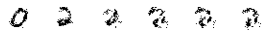

In [ ]:

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import scienceplots

plt.style.use('science')


digito = 2
digitfrom = 0

dfrom = chosenDigit[digitfrom]
dto = chosenDigit[digito]

plt.axvline(x=0, color='black', linestyle='--')
plt.axvline(x=1, color='black', linestyle='--')
plt.title("Energy landscape in a 3D space. \nLinear interpolation from digit 0 to 2")
plt.plot(ranget, energiess)
plt.show()


diff = dto - dfrom
line = [dfrom + diff*t for t in range(6)]

for i in range(0, len(line)):
    vis = hidden_to_visible(line[i], model)
    for _ in range(100):
        vis = model.gibbs(vis)
    
    # Add each image as a subplot in the bottom row
    ax = plt.subplot(2, len(line), len(line) + i + 1)
    ax.imshow(np.reshape(1-vis, (28, 28)), cmap="gray")
    ax.set_xticks([])
    ax.set_yticks([])
    pos = ax.get_position()
    if i == 0:
        ax.set_position([pos.x0, pos.y0 - 0.29, 0.1, 0.1])
    elif i == len(line)-1:
        ax.set_position([pos.x0, pos.y0 - 0.29, 0.1, 0.1])
    else:
        ax.set_position([pos.x0, pos.y0 - 0.29, 0.1, 0.1])
    #ax.set_position([(i)/7, 0.0, 0.2, 0.1])
    ax.set_axis_off()


#visto = hidden_to_visible(dto, model)
#visfrom = hidden_to_visible(dfrom, model)

#inset_ax = inset_axes(ax, width="20%", height="20%", loc="lower left") 
#inset_ax.imshow(visfrom.reshape(28,28), cmap="gray")
#inset_ax.axis("off")  # Rimuove gli assi per l'immagine

#inset_ax = inset_axes(ax, width="20%", height="20%", loc="upper right") 
#inset_ax.imshow(visto.reshape(28,28), cmap="gray")
#inset_ax.axis("off")  # Rimuove gli assi per l'immagine

ax.xaxis.set_label_coords(0.5, -0.5)
plt.savefig("euclidean_1.pdf", dpi=300, bbox_inches='tight')
ax.grid()
plt.show()
